# Advanced Computer Vision - Week_02 - SIFT (Scale-Invariant Feature Transform)

In [1]:
# import packages
from  skimage import data, transform
import matplotlib.pyplot as plt
from skimage import color
from skimage.color import rgb2gray
import numpy as np
from scipy import signal
from scipy.ndimage import gaussian_filter
from scipy.ndimage import maximum_filter,minimum_filter
from skimage.morphology import binary_dilation,rectangle
from skimage.feature import hessian_matrix
import cv2
# NOTE: OPEN FILE STRUCTURE NAVIGATOR

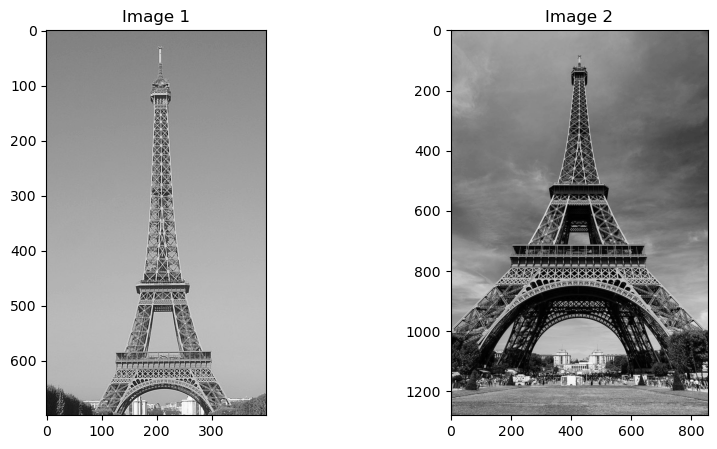

In [24]:
# Load the images
img1 = color.rgb2gray(plt.imread('_data/eifel_1.jpeg')[:700, 300:700])
img2 = color.rgb2gray(plt.imread('_data/eifel_2.jpeg'))

# img1 = color.rgb2gray(plt.imread('_data/inst_1.png'))
# img2 = color.rgb2gray(plt.imread('_data/inst_2.png'))
# img1 = transform.rescale(img1, 0.5)[300:,:]
# img2 = transform.rescale(img2, 0.5)
# Display the images
plt.figure(figsize=(10, 5))

# Plot the first image
plt.subplot(1, 2, 1)
plt.imshow(img1, cmap="gray")
plt.title('Image 1')

# Plot the second image
plt.subplot(1, 2, 2)
plt.imshow(img2, cmap="gray")
plt.title('Image 2')

plt.show()

In [25]:
from sift import Sift
sift_1 = Sift(img1)
sift_2 = Sift(img2)

In [26]:
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=2, sigmas=sift_1.sigmas_array, visualization=False)
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=1, sigmas=sift_1.sigmas_array, visualization=False)
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=0.5, sigmas=sift_1.sigmas_array, visualization=False)
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=0.25, sigmas=sift_1.sigmas_array, visualization=False)

Number of keypoints candidates: 1113
Number of keypoints candidates: 373
Number of keypoints candidates: 664
Number of keypoints candidates: 1104


In [27]:
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=2, sigmas=sift_1.sigmas_array, visualization=False)
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=1, sigmas=sift_1.sigmas_array, visualization=False)
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=0.5, sigmas=sift_1.sigmas_array, visualization=False)
# sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=0.25, sigmas=sift_1.sigmas_array, visualization=False)

Number of keypoints candidates: 5663
Number of keypoints candidates: 4834
Number of keypoints candidates: 4844


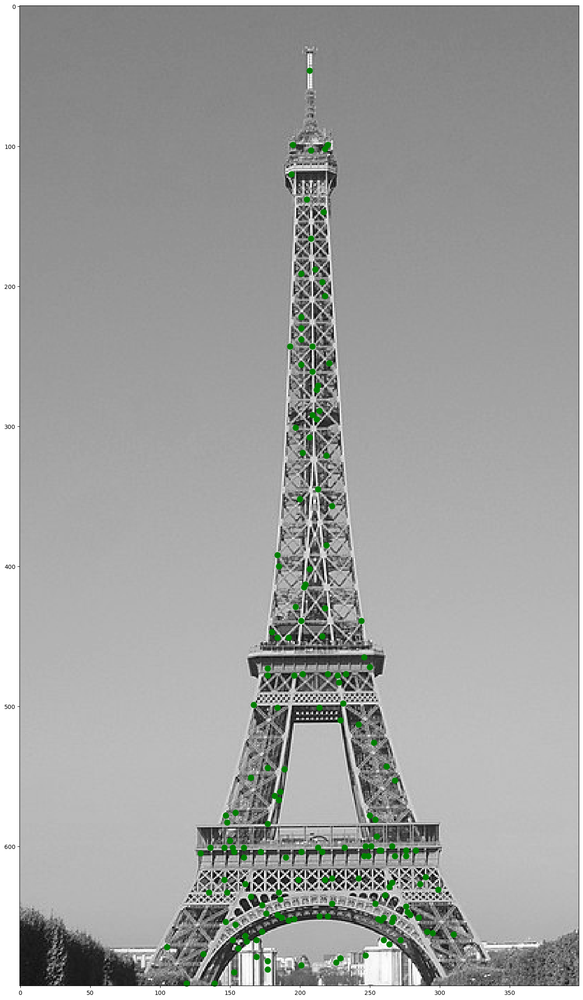

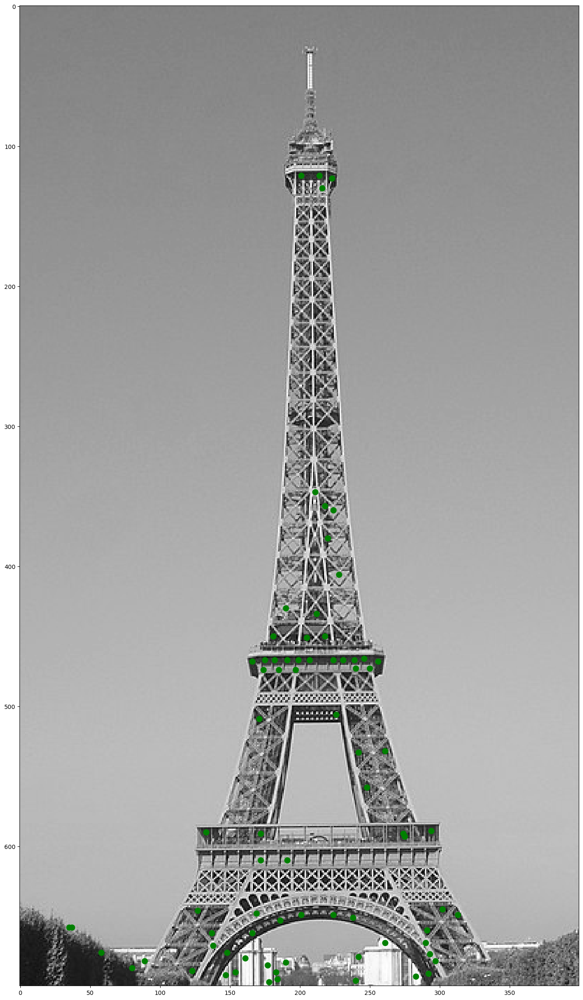

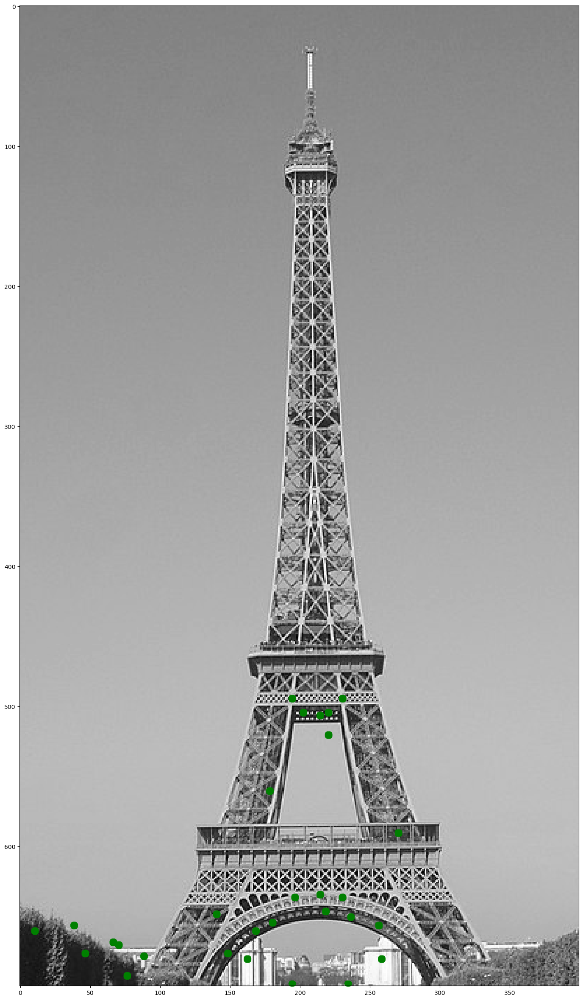

In [28]:
# Filtering
keypoints_1_0 = sift_1.filter_keypoints_in_octave(octave_index=0)
keypoints_1_1 = sift_1.filter_keypoints_in_octave(octave_index=1)
keypoints_1_2 = sift_1.filter_keypoints_in_octave(octave_index=2)
# keypoints_4_0 = sift_1.filter_keypoints_in_octave(octave_index=3)
# keypoints_2_0 = sift_2.filter_keypoints_in_octave(0)



/Users/hlibokymaros/Documents/KKUI/Advanced-computer-vision/sift.py:193: RuntimeWarning: divide by zero encountered in divide
  principal_curv_ratio = trace_h**2 / det_h
/Users/hlibokymaros/Documents/KKUI/Advanced-computer-vision/sift.py:193: RuntimeWarning: invalid value encountered in divide
  principal_curv_ratio = trace_h**2 / det_h


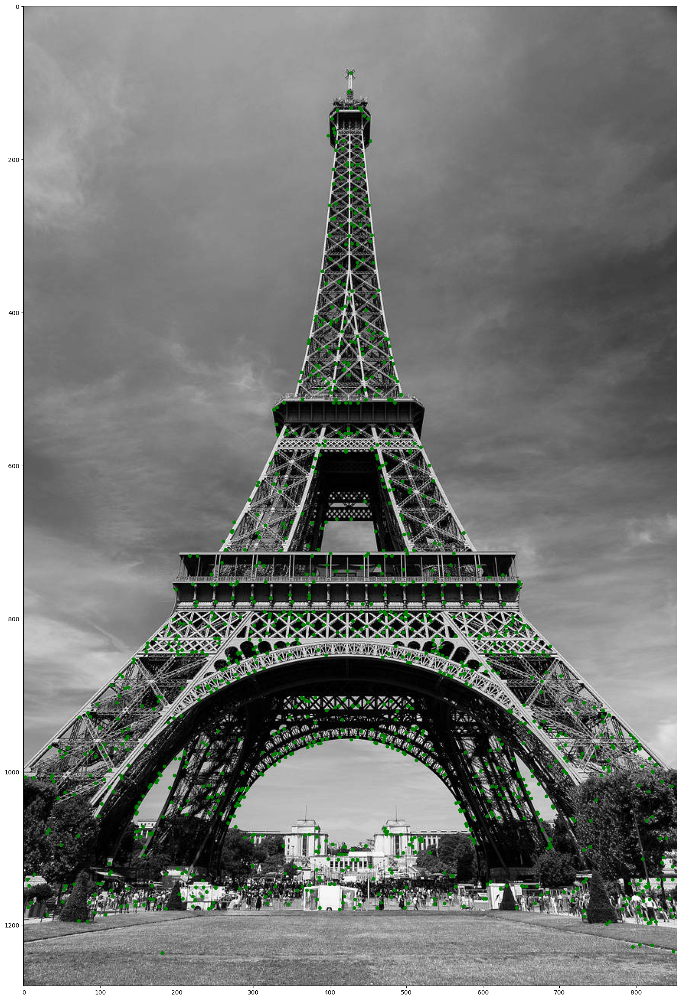

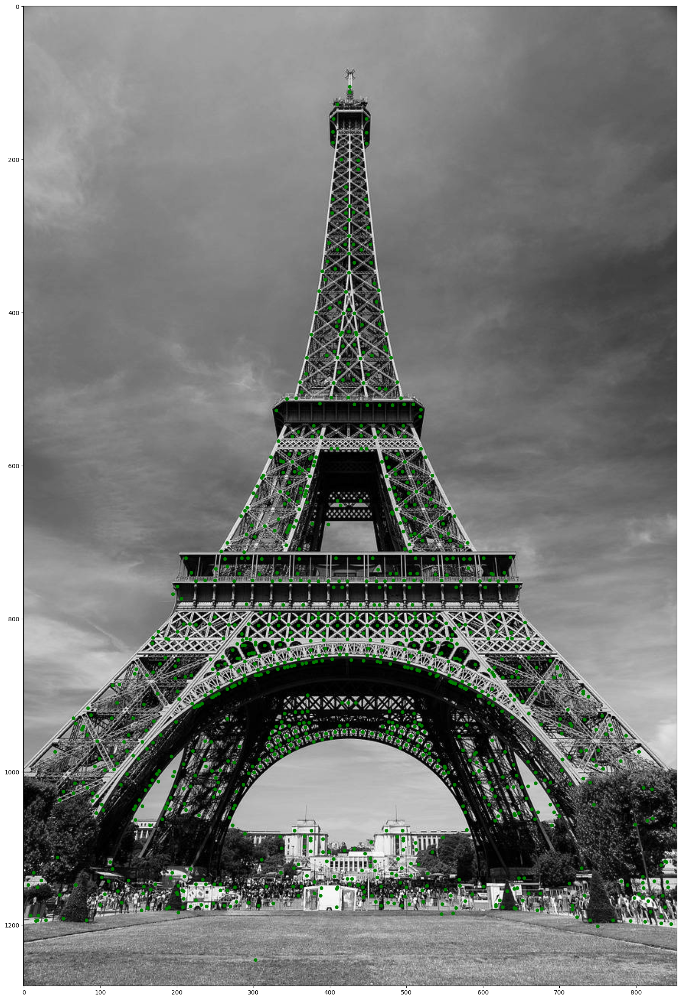

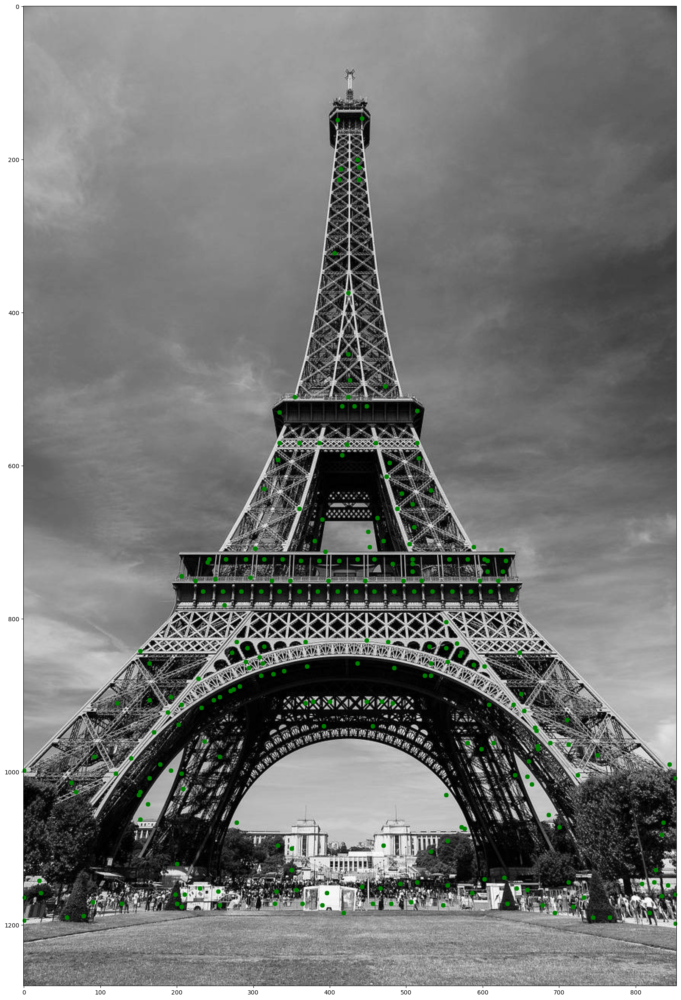

In [29]:
# Filtering
keypoints_2_0 = sift_2.filter_keypoints_in_octave(octave_index=0)
keypoints_2_1 = sift_2.filter_keypoints_in_octave(octave_index=1)
keypoints_2_2 = sift_2.filter_keypoints_in_octave(octave_index=2)
# keypoints_4_0 = sift_1.filter_keypoints_in_octave(octave_index=3)
# keypoints_2_0 = sift_2.filter_keypoints_in_octave(0)

In [30]:
keypoints_1 = keypoints_1_0 + keypoints_1_1 + keypoints_1_2
keypoints_2 = keypoints_2_0 + keypoints_2_1 + keypoints_2_2

# keypoints_1 = keypoints_1_0 * keypoints_1_1 * keypoints_1_2
# keypoints_2 = keypoints_2_0 * keypoints_2_1 * keypoints_2_2

# keypoints_1 = keypoints_1_0
# keypoints_2 = keypoints_2_0


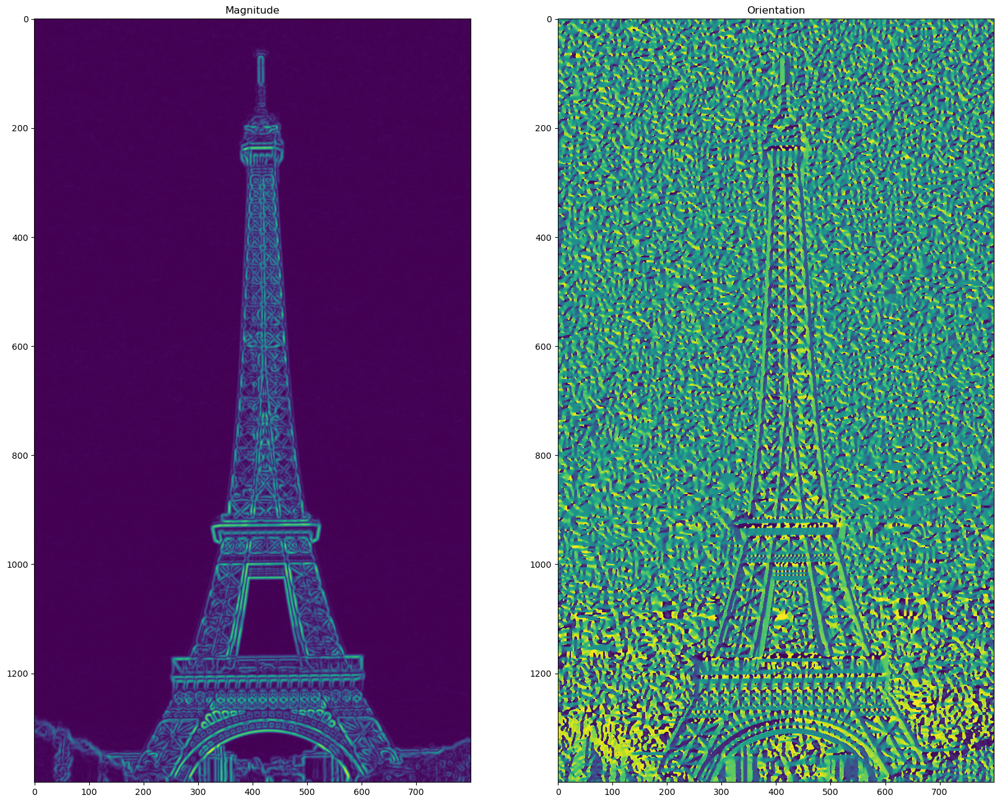

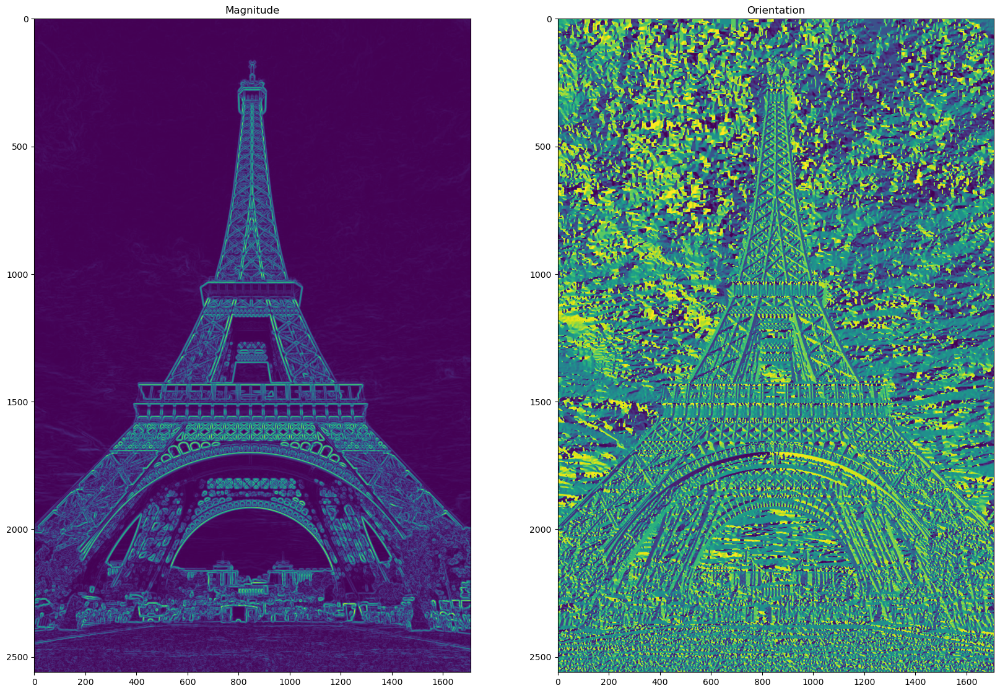

In [31]:
histrogram_array_1_0 = sift_1.get_keypoints_histgoram(keypoints_1)
histrogram_array_2_0 = sift_2.get_keypoints_histgoram(keypoints_2)

In [32]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

# bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
# # Convert arrays to compatible data types
# histrogram_array_1_0 = histrogram_array_1_0.astype(np.uint8)
# histrogram_array_2_0 = histrogram_array_2_0.astype(np.uint8)
# bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(histrogram_array_1_0,histrogram_array_2_0)
matches = sorted(matches, key = lambda x:x.distance)
len(matches)

130

In [33]:
matches

[< cv2.DMatch 0x161de2f30>,
 < cv2.DMatch 0x161de2cf0>,
 < cv2.DMatch 0x161de2df0>,
 < cv2.DMatch 0x161de2d30>,
 < cv2.DMatch 0x161de2eb0>,
 < cv2.DMatch 0x161de2ad0>,
 < cv2.DMatch 0x161de2c10>,
 < cv2.DMatch 0x161de2070>,
 < cv2.DMatch 0x161de2bd0>,
 < cv2.DMatch 0x161de2cd0>,
 < cv2.DMatch 0x161de23d0>,
 < cv2.DMatch 0x161de2ab0>,
 < cv2.DMatch 0x161de22f0>,
 < cv2.DMatch 0x161dbabd0>,
 < cv2.DMatch 0x161de2b90>,
 < cv2.DMatch 0x161de2bf0>,
 < cv2.DMatch 0x161de2c30>,
 < cv2.DMatch 0x161de2110>,
 < cv2.DMatch 0x161de2a10>,
 < cv2.DMatch 0x161de2a90>,
 < cv2.DMatch 0x161de2cb0>,
 < cv2.DMatch 0x161de26b0>,
 < cv2.DMatch 0x161de2810>,
 < cv2.DMatch 0x161de22d0>,
 < cv2.DMatch 0x161de2850>,
 < cv2.DMatch 0x161de2390>,
 < cv2.DMatch 0x161de2270>,
 < cv2.DMatch 0x161de29b0>,
 < cv2.DMatch 0x161de28b0>,
 < cv2.DMatch 0x161de2bb0>,
 < cv2.DMatch 0x161de2870>,
 < cv2.DMatch 0x161de29f0>,
 < cv2.DMatch 0x161de24b0>,
 < cv2.DMatch 0x161de2a30>,
 < cv2.DMatch 0x161de2a50>,
 < cv2.DMatch 0x161d

In [34]:
histrogram_array_1_0

array([[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [0.0000000e+00, 0.0000000e+00, 5.6758511e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [4.7112659e-05, 0.0000000e+00, 1.0801154e-03, ..., 6.6418998e-04,
        1.2897061e-03, 5.3077261e-04],
       [4.7112659e-05, 0.0000000e+00, 0.0000000e+00, ..., 2.4735723e-03,
        1.2897061e-03, 5.3077261e-04]], dtype=float32)

In [35]:
# # Extract coordinates from your keypoints
# keypoints_1_coords = np.array([kp.pt for kp in keypoints_1])
# keypoints_2_coords = np.array([kp.pt for kp in keypoints_2])

# Convert coordinates to cv2.KeyPoint format
cv_keypoints_1 = [cv2.KeyPoint(int(x[1]), int(x[0]), 1) for x in np.array(np.where(keypoints_1)).T]
cv_keypoints_2 = [cv2.KeyPoint(int(x[1]), int(x[0]), 1) for x in np.array(np.where(keypoints_2)).T]

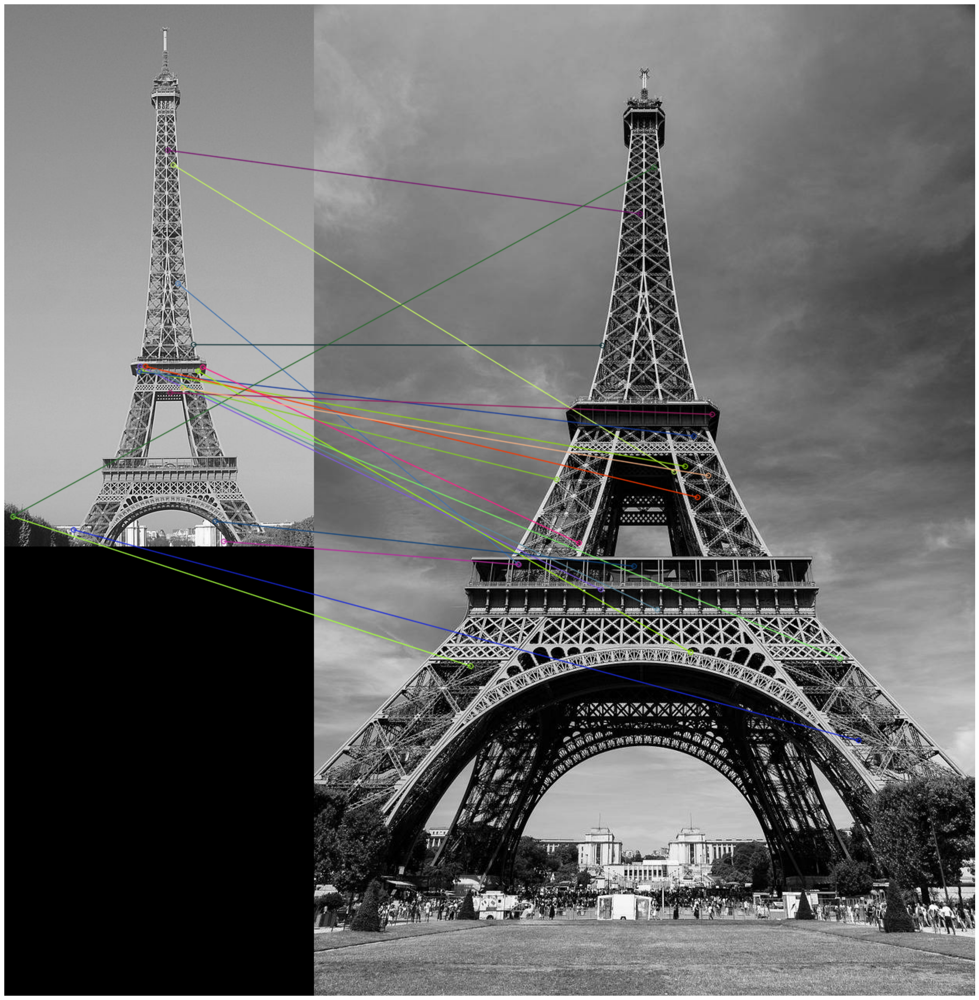

In [36]:
# # Convert coordinates to cv2.KeyPoint format
# cv_keypoints_1 = [cv2.KeyPoint(x, y, 1) for x, y in keypoints_1_coords]
# cv_keypoints_2 = [cv2.KeyPoint(x, y, 1) for x, y in keypoints_2_coords]
#
# # Draw matches

# Convert images to supported types (e.g., CV_8UC1)
img1_uint8 = (img1 * 255).astype(np.uint8)
img2_uint8 = (img2 * 255).astype(np.uint8)

# Convert grayscale images to BGR
img1_rgb = cv2.cvtColor(img1_uint8, cv2.COLOR_GRAY2BGR)
img2_rgb = cv2.cvtColor(img2_uint8, cv2.COLOR_GRAY2BGR)


# Draw matches
img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, matches[:20], img2_rgb, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(img3)
plt.axis('off')
plt.show()

In [37]:
bf = cv2.BFMatcher_create()
matches = bf.knnMatch(histrogram_array_1_0, histrogram_array_2_0,k=2)

In [38]:
good_matches = []

for m1, m2 in matches:
    if m1.distance < 0.6*m2.distance:
        good_matches.append(m1)

In [39]:
len(good_matches)

10

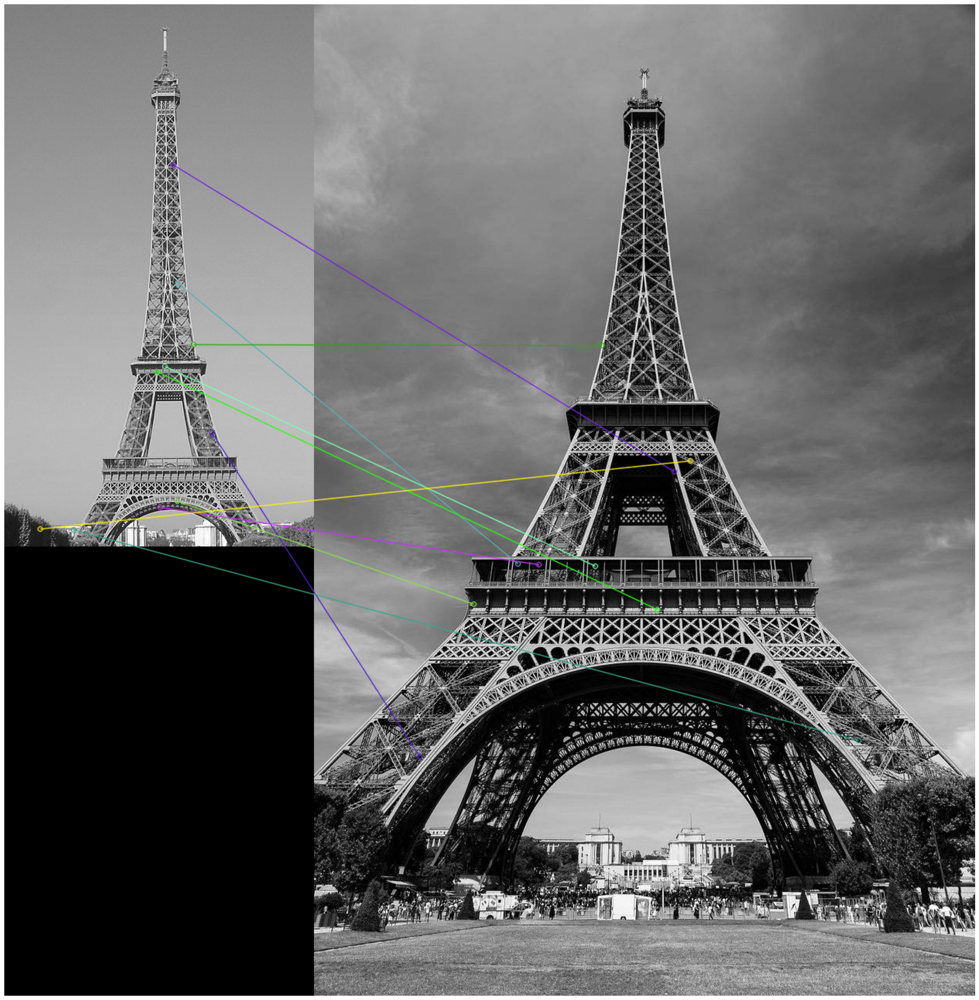

In [40]:
# Draw matches
img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, good_matches, None, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(img3)
plt.axis('off')
plt.show()

In [19]:
good_matches

[< cv2.DMatch 0x1622a9d10>,
 < cv2.DMatch 0x1622a9bb0>,
 < cv2.DMatch 0x1622a9e70>,
 < cv2.DMatch 0x1622a9cb0>,
 < cv2.DMatch 0x1622ba090>,
 < cv2.DMatch 0x1622ba0d0>,
 < cv2.DMatch 0x1622ba2d0>,
 < cv2.DMatch 0x1622ba690>,
 < cv2.DMatch 0x1622baa10>,
 < cv2.DMatch 0x1622baa90>,
 < cv2.DMatch 0x1622bac50>,
 < cv2.DMatch 0x1622bacd0>,
 < cv2.DMatch 0x1622bad10>,
 < cv2.DMatch 0x1622bad90>,
 < cv2.DMatch 0x1622bae10>,
 < cv2.DMatch 0x1622bafd0>,
 < cv2.DMatch 0x1622bb0d0>,
 < cv2.DMatch 0x1622bb110>,
 < cv2.DMatch 0x1622bb590>,
 < cv2.DMatch 0x1622bb5d0>,
 < cv2.DMatch 0x1622bb610>,
 < cv2.DMatch 0x1622bb710>,
 < cv2.DMatch 0x1622bbc10>,
 < cv2.DMatch 0x1622bbc90>,
 < cv2.DMatch 0x1622bbd10>,
 < cv2.DMatch 0x1622bbd90>,
 < cv2.DMatch 0x1622bbf10>,
 < cv2.DMatch 0x1622bbf90>,
 < cv2.DMatch 0x1622bbfd0>,
 < cv2.DMatch 0x1622bc250>,
 < cv2.DMatch 0x1622bc350>,
 < cv2.DMatch 0x1622bc510>,
 < cv2.DMatch 0x1622bc5d0>,
 < cv2.DMatch 0x1622bc6d0>,
 < cv2.DMatch 0x1622bc950>,
 < cv2.DMatch 0x1622

[ WARN:0@0.296] global shadow_sift.hpp:15 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


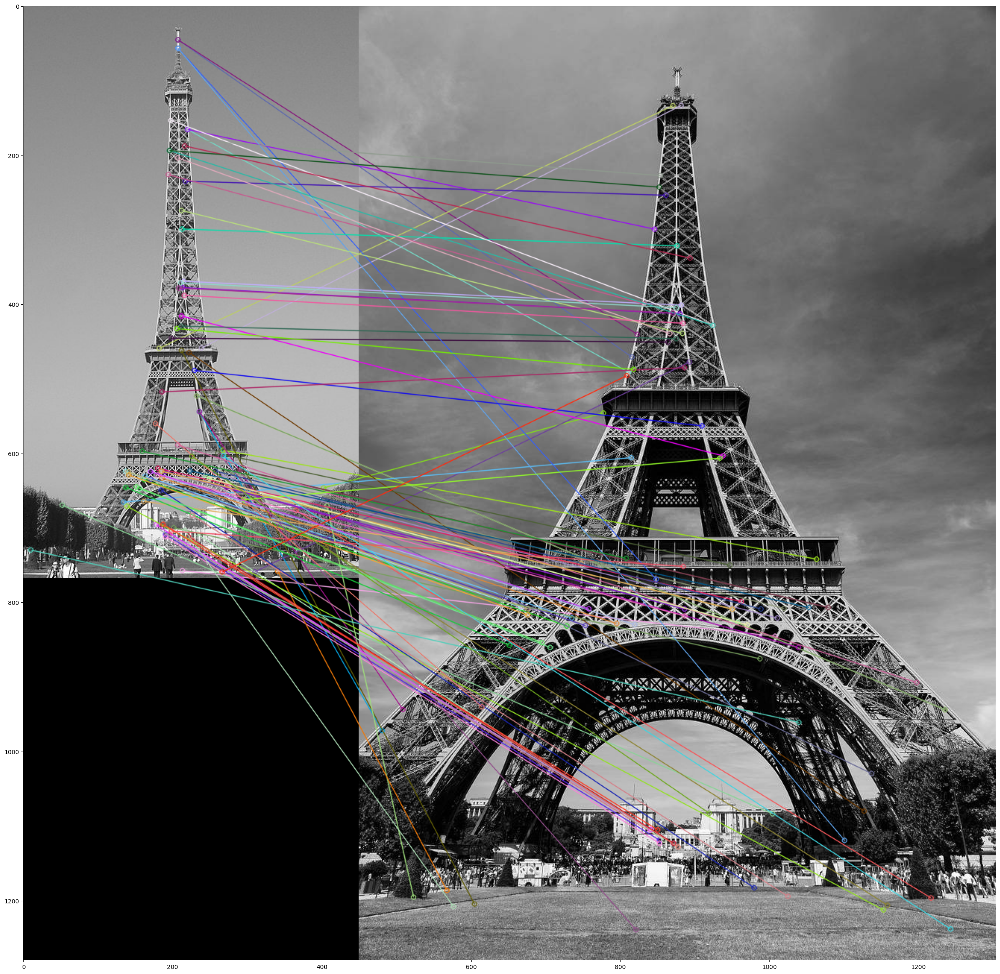

In [1]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

# read images
img1 = cv2.imread('_data/eifel_1.jpeg')[:,300:750]
img2 = cv2.imread('_data/eifel_2.jpeg')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#sift
sift = cv2.xfeatures2d.SIFT_create()

keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:100], img2, flags=2)
plt.figure(figsize=(30,30))
plt.imshow(img3)
plt.show()

In [65]:
!pip install opencv-contrib-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.2/44.2 MB 2.9 MB/s eta 0:00:0000:0100:01


In [10]:
len(keypoints_1)

1099

In [64]:
type(descriptors_1[0,0])

numpy.float32

In [18]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1[:,:20],descriptors_2[:,:20])

In [19]:
len(descriptors_2)

5888

In [62]:
matches[0]

< cv2.DMatch 0x12fe9e4b0>

In [2]:
matches = bf.knnMatch (descriptors_1, descriptors_2,k=2)

error: OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/core/src/batch_distance.cpp:303: error: (-215:Assertion failed) K == 1 && update == 0 && mask.empty() in function 'batchDistance'


In [9]:
import numpy as np
img1_gray = img1
img2_gray = img2

In [10]:
# Create our ORB detector and detect keypoints and descriptors
orb = cv2.ORB_create()

In [11]:
# Find keypoints and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(img1, None)
keypoints2, descriptors2 = orb.detectAndCompute(img2, None)

In [12]:
# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv2.BFMatcher_create(cv2.NORM_HAMMING,crossCheck=True)

In [13]:
matches = bf.match(descriptors1, descriptors2)

In [14]:
matches = sorted(matches,key=lambda x:x.distance)

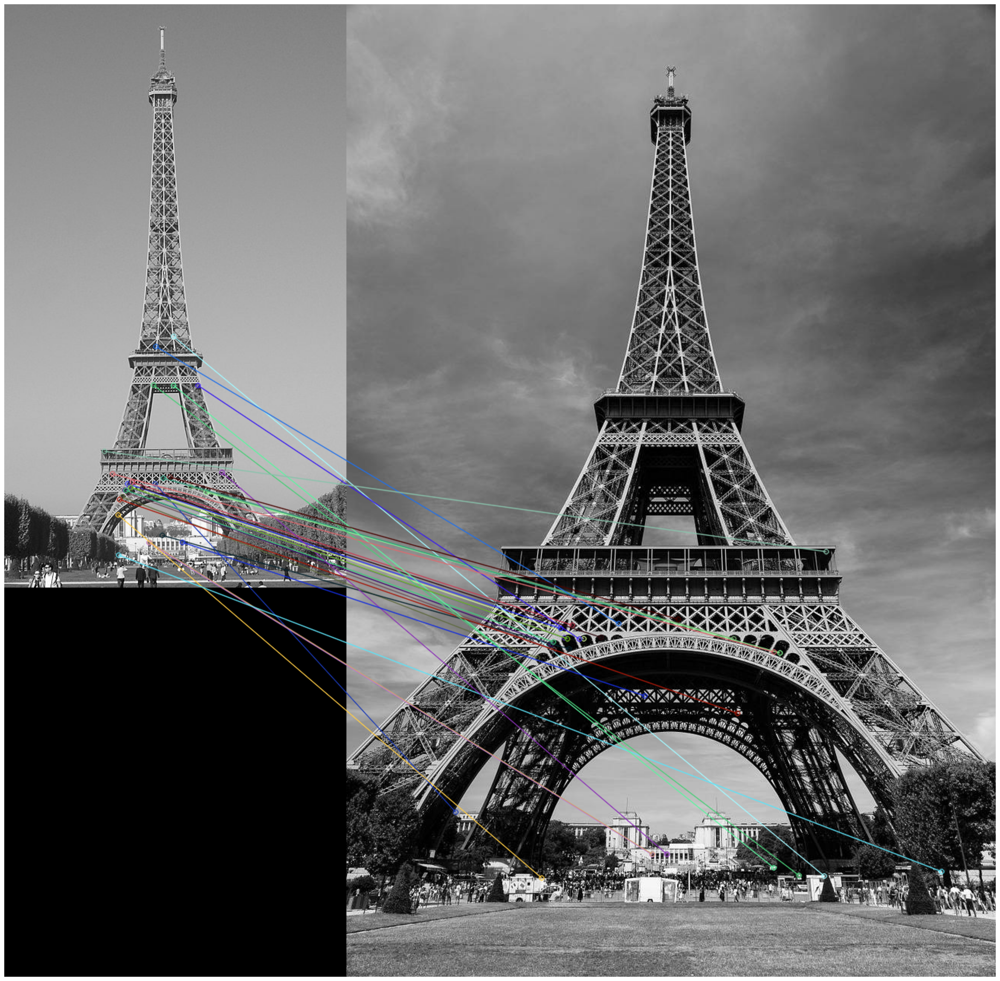

In [17]:
ORB_matches =cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches[:30], None, flags=2)
# Draw matches
# img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, matches[:20], img2_rgb, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(ORB_matches)
plt.axis('off')
plt.show()

In [19]:
bf = cv2.BFMatcher_create()
matches = bf.knnMatch(descriptors1, descriptors2,k=2)

In [20]:
matches

((< cv2.DMatch 0x111f67690>, < cv2.DMatch 0x17f0b7e10>),
 (< cv2.DMatch 0x17480af50>, < cv2.DMatch 0x17480af70>),
 (< cv2.DMatch 0x17480afb0>, < cv2.DMatch 0x17480add0>),
 (< cv2.DMatch 0x17480aed0>, < cv2.DMatch 0x17480ae90>),
 (< cv2.DMatch 0x17480aeb0>, < cv2.DMatch 0x17480ae30>),
 (< cv2.DMatch 0x17480ae50>, < cv2.DMatch 0x17480ae70>),
 (< cv2.DMatch 0x17480af10>, < cv2.DMatch 0x17480af30>),
 (< cv2.DMatch 0x17480adb0>, < cv2.DMatch 0x17480ad90>),
 (< cv2.DMatch 0x17480ad70>, < cv2.DMatch 0x17480ad50>),
 (< cv2.DMatch 0x17480ad30>, < cv2.DMatch 0x17480ad10>),
 (< cv2.DMatch 0x17480acf0>, < cv2.DMatch 0x17480acd0>),
 (< cv2.DMatch 0x17480acb0>, < cv2.DMatch 0x17480ac90>),
 (< cv2.DMatch 0x17480ac70>, < cv2.DMatch 0x17480ac50>),
 (< cv2.DMatch 0x17480ac30>, < cv2.DMatch 0x17480ac10>),
 (< cv2.DMatch 0x17480abf0>, < cv2.DMatch 0x17480abd0>),
 (< cv2.DMatch 0x17480abb0>, < cv2.DMatch 0x17480ab90>),
 (< cv2.DMatch 0x17480ab70>, < cv2.DMatch 0x17480ab50>),
 (< cv2.DMatch 0x17480ab30>, < 